# Credit EDA Assignment - Badal Autade

In [1]:
# Import all important required python libraries.
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [2]:
# Import Warning library to ignore unnecessary warnings while plotting graphs.
import warnings
warnings.filterwarnings('ignore')

In [3]:
# Import and read Application data file.
df = pd.read_csv('application_data.csv')
df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,1.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,0,0,0,0,NaN,NaN,NaN,NaN,NaN,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,0,0,0,0,0.0,0.0,0.0,0.0,0.0,0.0


In [4]:
# Find the Sahape of application data.
df.shape

(307511, 122)

In [5]:
# Import and read previous application data file.
inp1 = pd.read_csv('previous_application.csv')
inp1.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# Find the Sahape of previous application data.
inp1.shape

(1670214, 37)

# We will take Application data file first

In [7]:
# Find data type of all columns in Application data file.
df.info(True)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 122 columns):
 #    Column                        Dtype  
---   ------                        -----  
 0    SK_ID_CURR                    int64  
 1    TARGET                        int64  
 2    NAME_CONTRACT_TYPE            object 
 3    CODE_GENDER                   object 
 4    FLAG_OWN_CAR                  object 
 5    FLAG_OWN_REALTY               object 
 6    CNT_CHILDREN                  int64  
 7    AMT_INCOME_TOTAL              float64
 8    AMT_CREDIT                    float64
 9    AMT_ANNUITY                   float64
 10   AMT_GOODS_PRICE               float64
 11   NAME_TYPE_SUITE               object 
 12   NAME_INCOME_TYPE              object 
 13   NAME_EDUCATION_TYPE           object 
 14   NAME_FAMILY_STATUS            object 
 15   NAME_HOUSING_TYPE             object 
 16   REGION_POPULATION_RELATIVE    float64
 17   DAYS_BIRTH                    int64  
 18   DA

In [8]:
df.describe()

,SK_ID_CURR,TARGET,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,AMT_GOODS_PRICE,REGION_POPULATION_RELATIVE,DAYS_BIRTH,DAYS_EMPLOYED,...,FLAG_DOCUMENT_18,FLAG_DOCUMENT_19,FLAG_DOCUMENT_20,FLAG_DOCUMENT_21,AMT_REQ_CREDIT_BUREAU_HOUR,AMT_REQ_CREDIT_BUREAU_DAY,AMT_REQ_CREDIT_BUREAU_WEEK,AMT_REQ_CREDIT_BUREAU_MON,AMT_REQ_CREDIT_BUREAU_QRT,AMT_REQ_CREDIT_BUREAU_YEAR
count,307511.000000,307511.000000,307511.000000,3.075110e+05,3.075110e+05,307499.000000,3.072330e+05,307511.000000,307511.000000,307511.000000,...,307511.000000,307511.000000,307511.000000,307511.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000,265992.000000
mean,278180.518577,0.080729,0.417052,1.687979e+05,5.990260e+05,27108.573909,5.383962e+05,0.020868,-16036.995067,63815.045904,...,0.008130,0.000595,0.000507,0.000335,0.006402,0.007000,0.034362,0.267395,0.265474,1.899974
std,102790.175348,0.272419,0.722121,2.371231e+05,4.024908e+05,14493.737315,3.694465e+05,0.013831,4363.988632,141275.766519,...,0.089798,0.024387,0.022518,0.018299,0.083849,0.110757,0.204685,0.916002,0.794056,1.869295
min,100002.000000,0.000000,0.000000,2.565000e+04,4.500000e+04,1615.500000,4.050000e+04,0.000290,-25229.000000,-17912.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,189145.500000,0.000000,0.000000,1.125000e+05,2.700000e+05,16524.000000,2.385000e+05,0.010006,-19682.000000,-2760.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,278202.000000,0.000000,0.000000,1.471500e+05,5.135310e+05,24903.000000,4.500000e+05,0.018850,-15750.000000,-1213.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
75%,367142.500000,0.000000,1.000000,2.025000e+05,8.086500e+05,34596.000000,6.795000e+05,0.028663,-12413.000000,-289.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,3.000000
max,456255.000000,1.000000,19.000000,1.170000e+08,4.050000e+06,258025.500000,4.050000e+06,0.072508,-7489.000000,365243.000000,...,1.000000,1.000000,1.000000,1.000000,4.000000,9.000000,8.000000,27.000000,261.000000,25.000000


In [9]:
# Find the null cells in Application data file.
df.isnull().sum()

SK_ID_CURR                        0
TARGET                            0
NAME_CONTRACT_TYPE                0
CODE_GENDER                       0
FLAG_OWN_CAR                      0
                              ...  
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_YEAR    41519
Length: 122, dtype: int64

In [10]:
# Descending order of column wise null cells.
df.isnull().sum().sort_values(ascending = False).head(30)

COMMONAREA_MEDI             214865
COMMONAREA_AVG              214865
COMMONAREA_MODE             214865
NONLIVINGAPARTMENTS_MODE    213514
NONLIVINGAPARTMENTS_AVG     213514
NONLIVINGAPARTMENTS_MEDI    213514
FONDKAPREMONT_MODE          210295
LIVINGAPARTMENTS_MODE       210199
LIVINGAPARTMENTS_AVG        210199
LIVINGAPARTMENTS_MEDI       210199
FLOORSMIN_AVG               208642
FLOORSMIN_MODE              208642
FLOORSMIN_MEDI              208642
YEARS_BUILD_MEDI            204488
YEARS_BUILD_MODE            204488
YEARS_BUILD_AVG             204488
OWN_CAR_AGE                 202929
LANDAREA_MEDI               182590
LANDAREA_MODE               182590
LANDAREA_AVG                182590
BASEMENTAREA_MEDI           179943
BASEMENTAREA_AVG            179943
BASEMENTAREA_MODE           179943
EXT_SOURCE_1                173378
NONLIVINGAREA_MODE          169682
NONLIVINGAREA_AVG           169682
NONLIVINGAREA_MEDI          169682
ELEVATORS_MEDI              163891
ELEVATORS_AVG       

In [11]:
# creating new variable for percentage of blank cells
blank_cells = df.isnull().sum()/len(df)*100
blank_cells

SK_ID_CURR                     0.000000
TARGET                         0.000000
NAME_CONTRACT_TYPE             0.000000
CODE_GENDER                    0.000000
FLAG_OWN_CAR                   0.000000
                                ...    
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
Length: 122, dtype: float64

In [12]:
blank_cells.sort_values(ascending = False).head(30)

COMMONAREA_MEDI             69.872297
COMMONAREA_AVG              69.872297
COMMONAREA_MODE             69.872297
NONLIVINGAPARTMENTS_MODE    69.432963
NONLIVINGAPARTMENTS_AVG     69.432963
NONLIVINGAPARTMENTS_MEDI    69.432963
FONDKAPREMONT_MODE          68.386172
LIVINGAPARTMENTS_MODE       68.354953
LIVINGAPARTMENTS_AVG        68.354953
LIVINGAPARTMENTS_MEDI       68.354953
FLOORSMIN_AVG               67.848630
FLOORSMIN_MODE              67.848630
FLOORSMIN_MEDI              67.848630
YEARS_BUILD_MEDI            66.497784
YEARS_BUILD_MODE            66.497784
YEARS_BUILD_AVG             66.497784
OWN_CAR_AGE                 65.990810
LANDAREA_MEDI               59.376738
LANDAREA_MODE               59.376738
LANDAREA_AVG                59.376738
BASEMENTAREA_MEDI           58.515956
BASEMENTAREA_AVG            58.515956
BASEMENTAREA_MODE           58.515956
EXT_SOURCE_1                56.381073
NONLIVINGAREA_MODE          55.179164
NONLIVINGAREA_AVG           55.179164
NONLIVINGARE

# Data Cleaning

In [13]:
# more than 40% of blank cells
blank_cells = blank_cells[blank_cells > 40]

In [14]:
# Finding no of columns with more than 40% of blank cells.
len(blank_cells)

49

In [15]:
# Dropping columns with more than 4% of blank cells.
df = df.drop(columns = blank_cells.index)

In [16]:
# Shape of data frame after dropping columns.
df.shape

(307511, 73)

In [17]:
df.isnull().sum().sort_values(ascending = False).head(30)

OCCUPATION_TYPE               96391
EXT_SOURCE_3                  60965
AMT_REQ_CREDIT_BUREAU_YEAR    41519
AMT_REQ_CREDIT_BUREAU_QRT     41519
AMT_REQ_CREDIT_BUREAU_MON     41519
AMT_REQ_CREDIT_BUREAU_WEEK    41519
AMT_REQ_CREDIT_BUREAU_DAY     41519
AMT_REQ_CREDIT_BUREAU_HOUR    41519
NAME_TYPE_SUITE                1292
OBS_30_CNT_SOCIAL_CIRCLE       1021
DEF_30_CNT_SOCIAL_CIRCLE       1021
OBS_60_CNT_SOCIAL_CIRCLE       1021
DEF_60_CNT_SOCIAL_CIRCLE       1021
EXT_SOURCE_2                    660
AMT_GOODS_PRICE                 278
AMT_ANNUITY                      12
CNT_FAM_MEMBERS                   2
DAYS_LAST_PHONE_CHANGE            1
FLAG_DOCUMENT_17                  0
FLAG_DOCUMENT_18                  0
FLAG_DOCUMENT_21                  0
FLAG_DOCUMENT_20                  0
FLAG_DOCUMENT_19                  0
FLAG_DOCUMENT_2                   0
FLAG_DOCUMENT_3                   0
FLAG_DOCUMENT_4                   0
FLAG_DOCUMENT_5                   0
FLAG_DOCUMENT_16            

In [18]:
(df.isnull().sum()/len(df)*100).sort_values(ascending = False).head(30)

OCCUPATION_TYPE               31.345545
EXT_SOURCE_3                  19.825307
AMT_REQ_CREDIT_BUREAU_YEAR    13.501631
AMT_REQ_CREDIT_BUREAU_QRT     13.501631
AMT_REQ_CREDIT_BUREAU_MON     13.501631
AMT_REQ_CREDIT_BUREAU_WEEK    13.501631
AMT_REQ_CREDIT_BUREAU_DAY     13.501631
AMT_REQ_CREDIT_BUREAU_HOUR    13.501631
NAME_TYPE_SUITE                0.420148
OBS_30_CNT_SOCIAL_CIRCLE       0.332021
DEF_30_CNT_SOCIAL_CIRCLE       0.332021
OBS_60_CNT_SOCIAL_CIRCLE       0.332021
DEF_60_CNT_SOCIAL_CIRCLE       0.332021
EXT_SOURCE_2                   0.214626
AMT_GOODS_PRICE                0.090403
AMT_ANNUITY                    0.003902
CNT_FAM_MEMBERS                0.000650
DAYS_LAST_PHONE_CHANGE         0.000325
FLAG_DOCUMENT_17               0.000000
FLAG_DOCUMENT_18               0.000000
FLAG_DOCUMENT_21               0.000000
FLAG_DOCUMENT_20               0.000000
FLAG_DOCUMENT_19               0.000000
FLAG_DOCUMENT_2                0.000000
FLAG_DOCUMENT_3                0.000000


In [19]:
df.OCCUPATION_TYPE.isnull().sum()

96391

In [20]:
df.OCCUPATION_TYPE.isnull().sum()/len(df)*100

31.345545362604916

In [21]:
df.OCCUPATION_TYPE.value_counts()

Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

### Imputing blank cells in OCCUPATION_TYPE with Unknown

In [22]:
df['OCCUPATION_TYPE'] = df['OCCUPATION_TYPE'].fillna('Unknown')

In [23]:
df.OCCUPATION_TYPE.value_counts()

Unknown                  96391
Laborers                 55186
Sales staff              32102
Core staff               27570
Managers                 21371
Drivers                  18603
High skill tech staff    11380
Accountants               9813
Medicine staff            8537
Security staff            6721
Cooking staff             5946
Cleaning staff            4653
Private service staff     2652
Low-skill Laborers        2093
Waiters/barmen staff      1348
Secretaries               1305
Realty agents              751
HR staff                   563
IT staff                   526
Name: OCCUPATION_TYPE, dtype: int64

In [24]:
df.OCCUPATION_TYPE.isnull().sum()

0

### Dropping the unnecessary columns from the data set.

In [25]:
df.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL',
       'FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL', 'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS',
       'REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY',
       'WEEKDAY_APPR_PROCESS_START', 'HOUR_APPR_PROCESS_START',
       'REG_REGION_NOT_LIVE_REGION', 'REG_REGION_NOT_WORK_REGION',
       'LIVE_REGION_NOT_WORK_REGION', 'REG_CITY_NOT_LIVE_CITY',
       'REG_CITY_NOT_WORK_CITY', 'LIVE_CITY_NOT_WORK_CITY',
       'ORGANIZATION_TYPE', 'EXT_SOURCE_2', 'EXT_SOURCE_3',
       'OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_C

In [26]:
# from above output copy the flag document, amt req etc etc columns as it provides no info which is imp to us.
# New variable for unnecessary columns created.
drop_columns = ['FLAG_EMP_PHONE', 'FLAG_WORK_PHONE', 'FLAG_CONT_MOBILE', 'FLAG_PHONE',
       'FLAG_EMAIL','REGION_RATING_CLIENT', 'REGION_RATING_CLIENT_W_CITY','OBS_30_CNT_SOCIAL_CIRCLE', 'DEF_30_CNT_SOCIAL_CIRCLE',
       'OBS_60_CNT_SOCIAL_CIRCLE', 'DEF_60_CNT_SOCIAL_CIRCLE',
       'DAYS_LAST_PHONE_CHANGE','FLAG_DOCUMENT_2', 'FLAG_DOCUMENT_3',
       'FLAG_DOCUMENT_4', 'FLAG_DOCUMENT_5', 'FLAG_DOCUMENT_6',
       'FLAG_DOCUMENT_7', 'FLAG_DOCUMENT_8', 'FLAG_DOCUMENT_9',
       'FLAG_DOCUMENT_10', 'FLAG_DOCUMENT_11', 'FLAG_DOCUMENT_12',
       'FLAG_DOCUMENT_13', 'FLAG_DOCUMENT_14', 'FLAG_DOCUMENT_15',
       'FLAG_DOCUMENT_16', 'FLAG_DOCUMENT_17', 'FLAG_DOCUMENT_18',
       'FLAG_DOCUMENT_19', 'FLAG_DOCUMENT_20', 'FLAG_DOCUMENT_21','AMT_REQ_CREDIT_BUREAU_HOUR', 'AMT_REQ_CREDIT_BUREAU_DAY',
       'AMT_REQ_CREDIT_BUREAU_WEEK', 'AMT_REQ_CREDIT_BUREAU_MON',
       'AMT_REQ_CREDIT_BUREAU_QRT', 'AMT_REQ_CREDIT_BUREAU_YEAR']

In [27]:
df1 = df.drop(columns = drop_columns)

In [28]:
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,HOUR_APPR_PROCESS_START,REG_REGION_NOT_LIVE_REGION,REG_REGION_NOT_WORK_REGION,LIVE_REGION_NOT_WORK_REGION,REG_CITY_NOT_LIVE_CITY,REG_CITY_NOT_WORK_CITY,LIVE_CITY_NOT_WORK_CITY,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,10,0,0,0,0,0,0,Business Entity Type 3,0.262949,0.139376
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,11,0,0,0,0,0,0,School,0.622246,NaN
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,9,0,0,0,0,0,0,Government,0.555912,0.729567
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,17,0,0,0,0,0,0,Business Entity Type 3,0.650442,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,11,0,0,0,0,1,1,Religion,0.322738,NaN


In [29]:
# View pending columns in data frame.
df1.columns

Index(['SK_ID_CURR', 'TARGET', 'NAME_CONTRACT_TYPE', 'CODE_GENDER',
       'FLAG_OWN_CAR', 'FLAG_OWN_REALTY', 'CNT_CHILDREN', 'AMT_INCOME_TOTAL',
       'AMT_CREDIT', 'AMT_ANNUITY', 'AMT_GOODS_PRICE', 'NAME_TYPE_SUITE',
       'NAME_INCOME_TYPE', 'NAME_EDUCATION_TYPE', 'NAME_FAMILY_STATUS',
       'NAME_HOUSING_TYPE', 'REGION_POPULATION_RELATIVE', 'DAYS_BIRTH',
       'DAYS_EMPLOYED', 'DAYS_REGISTRATION', 'DAYS_ID_PUBLISH', 'FLAG_MOBIL',
       'OCCUPATION_TYPE', 'CNT_FAM_MEMBERS', 'WEEKDAY_APPR_PROCESS_START',
       'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION',
       'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY', 'ORGANIZATION_TYPE', 'EXT_SOURCE_2',
       'EXT_SOURCE_3'],
      dtype='object')

In [30]:
# from these 35 columns we can remove some more less importan columns which we missed to drop in previous step.
df1.drop(columns = ['NAME_TYPE_SUITE','REGION_POPULATION_RELATIVE','WEEKDAY_APPR_PROCESS_START',
       'HOUR_APPR_PROCESS_START', 'REG_REGION_NOT_LIVE_REGION',
       'REG_REGION_NOT_WORK_REGION', 'LIVE_REGION_NOT_WORK_REGION',
       'REG_CITY_NOT_LIVE_CITY', 'REG_CITY_NOT_WORK_CITY',
       'LIVE_CITY_NOT_WORK_CITY'], inplace = True)

In [31]:
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,-9461,-637,-3648.0,-2120,1,Laborers,1.0,Business Entity Type 3,0.262949,0.139376
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,-16765,-1188,-1186.0,-291,1,Core staff,2.0,School,0.622246,NaN
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,-19046,-225,-4260.0,-2531,1,Laborers,1.0,Government,0.555912,0.729567
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,-19005,-3039,-9833.0,-2437,1,Laborers,2.0,Business Entity Type 3,0.650442,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,-19932,-3038,-4311.0,-3458,1,Core staff,1.0,Religion,0.322738,NaN


In [32]:
df1.shape

(307511, 25)

In [33]:
df1.isnull().sum().sort_values(ascending = False)

EXT_SOURCE_3           60965
EXT_SOURCE_2             660
AMT_GOODS_PRICE          278
AMT_ANNUITY               12
CNT_FAM_MEMBERS            2
NAME_HOUSING_TYPE          0
ORGANIZATION_TYPE          0
OCCUPATION_TYPE            0
FLAG_MOBIL                 0
DAYS_ID_PUBLISH            0
DAYS_REGISTRATION          0
DAYS_EMPLOYED              0
DAYS_BIRTH                 0
SK_ID_CURR                 0
NAME_FAMILY_STATUS         0
TARGET                     0
NAME_INCOME_TYPE           0
AMT_CREDIT                 0
AMT_INCOME_TOTAL           0
CNT_CHILDREN               0
FLAG_OWN_REALTY            0
FLAG_OWN_CAR               0
CODE_GENDER                0
NAME_CONTRACT_TYPE         0
NAME_EDUCATION_TYPE        0
dtype: int64

### Checking data type column wise and then converting as per requirement.

In [34]:
df1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 307511 entries, 0 to 307510
Data columns (total 25 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   SK_ID_CURR           307511 non-null  int64  
 1   TARGET               307511 non-null  int64  
 2   NAME_CONTRACT_TYPE   307511 non-null  object 
 3   CODE_GENDER          307511 non-null  object 
 4   FLAG_OWN_CAR         307511 non-null  object 
 5   FLAG_OWN_REALTY      307511 non-null  object 
 6   CNT_CHILDREN         307511 non-null  int64  
 7   AMT_INCOME_TOTAL     307511 non-null  float64
 8   AMT_CREDIT           307511 non-null  float64
 9   AMT_ANNUITY          307499 non-null  float64
 10  AMT_GOODS_PRICE      307233 non-null  float64
 11  NAME_INCOME_TYPE     307511 non-null  object 
 12  NAME_EDUCATION_TYPE  307511 non-null  object 
 13  NAME_FAMILY_STATUS   307511 non-null  object 
 14  NAME_HOUSING_TYPE    307511 non-null  object 
 15  DAYS_BIRTH       

### TARGET Column

In [35]:
df1.TARGET.value_counts()

0    282686
1     24825
Name: TARGET, dtype: int64

### NAME_CONTRACT_TYPE column

In [36]:
df1.NAME_CONTRACT_TYPE.value_counts()

Cash loans         278232
Revolving loans     29279
Name: NAME_CONTRACT_TYPE, dtype: int64

### CODE_GENDER column

In [37]:
df1.CODE_GENDER.value_counts()

F      202448
M      105059
XNA         4
Name: CODE_GENDER, dtype: int64

In [38]:
# Replacing 4 cells of XNA with F as F is the mode
df1['CODE_GENDER'] = df['CODE_GENDER'].apply(lambda x: 'F' if x=='XNA' else x)

In [39]:
df1.CODE_GENDER.value_counts()

F    202452
M    105059
Name: CODE_GENDER, dtype: int64

### CNT_CHILDREN column

In [40]:
df1.CNT_CHILDREN.value_counts()

0     215371
1      61119
2      26749
3       3717
4        429
5         84
6         21
7          7
14         3
8          2
9          2
12         2
10         2
19         2
11         1
Name: CNT_CHILDREN, dtype: int64

<AxesSubplot:xlabel='CNT_CHILDREN'>

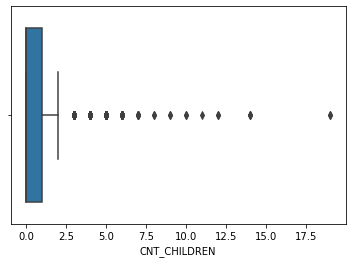

In [41]:
sns.boxplot(df['CNT_CHILDREN'])

In [42]:
df1 = df1[df1['CNT_CHILDREN']<=6]
df1.CNT_CHILDREN.value_counts()

0    215371
1     61119
2     26749
3      3717
4       429
5        84
6        21
Name: CNT_CHILDREN, dtype: int64

In [43]:
df1.AMT_INCOME_TOTAL.value_counts().sort_values(ascending=False)

135000.0    35750
112500.0    31015
157500.0    26555
180000.0    24717
90000.0     22483
            ...  
155790.0        1
186151.5        1
231075.0        1
107284.5        1
113062.5        1
Name: AMT_INCOME_TOTAL, Length: 2548, dtype: int64

### AMT_INCOME_TOTAL column 

<AxesSubplot:xlabel='AMT_INCOME_TOTAL'>

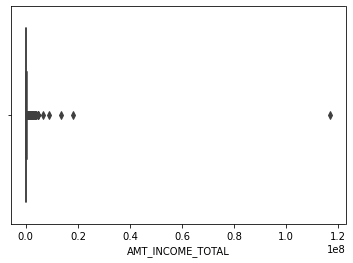

In [44]:
# Checking for outliers.
sns.boxplot(df1['AMT_INCOME_TOTAL'])

In [45]:
# Eliminating the outliers.
df1 = df1[df1['AMT_INCOME_TOTAL']<= 5000000]

<AxesSubplot:xlabel='AMT_INCOME_TOTAL'>

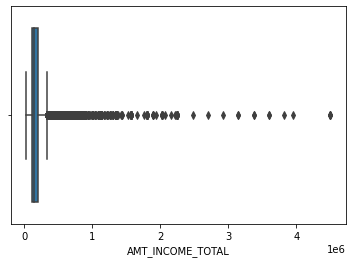

In [46]:
sns.boxplot(df1['AMT_INCOME_TOTAL'])

### AMT_CREDIT column

<AxesSubplot:xlabel='AMT_CREDIT'>

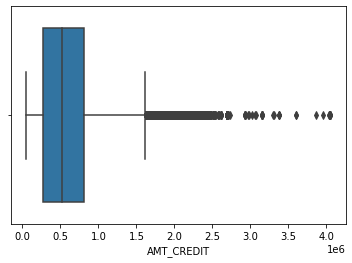

In [47]:
Checking outliers.
sns.boxplot(df1['AMT_CREDIT'])

In [48]:
# Eliminating the outliers.
df1 = df1[df1['AMT_CREDIT']<= 2500000]

<AxesSubplot:xlabel='AMT_CREDIT'>

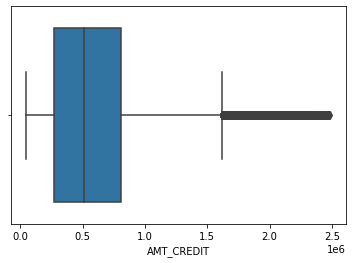

In [49]:
sns.boxplot(df1['AMT_CREDIT'])

### AMT_ANNUITY column

<AxesSubplot:xlabel='AMT_ANNUITY'>

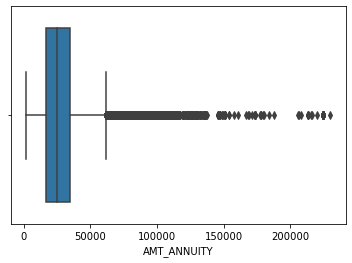

In [50]:
# Checking the outliers
sns.boxplot(df1['AMT_ANNUITY'])

In [51]:
# Eliminating the outliers.
df1 = df1[df1['AMT_ANNUITY']<= 140000]

<AxesSubplot:xlabel='AMT_ANNUITY'>

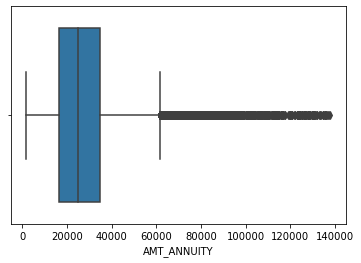

In [52]:
sns.boxplot(df1['AMT_ANNUITY'])

In [53]:
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,-9461,-637,-3648.0,-2120,1,Laborers,1.0,Business Entity Type 3,0.262949,0.139376
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,-16765,-1188,-1186.0,-291,1,Core staff,2.0,School,0.622246,NaN
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,-19046,-225,-4260.0,-2531,1,Laborers,1.0,Government,0.555912,0.729567
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,-19005,-3039,-9833.0,-2437,1,Laborers,2.0,Business Entity Type 3,0.650442,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,-19932,-3038,-4311.0,-3458,1,Core staff,1.0,Religion,0.322738,NaN


# Need to convert negative digits of DAYS_BIRTH & DAYS_EMPLOYED to positive digits and then convert to years

### Also need to convert negative digits of DAYS_REGISTRATION & DAYS_ID_PUBLISH to positive digits.

In [54]:
# first convert all these 4 columns to positive digits.(absolute nos)
df1[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH']] = df1[['DAYS_BIRTH','DAYS_EMPLOYED','DAYS_REGISTRATION','DAYS_ID_PUBLISH']].abs()

In [55]:
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,DAYS_BIRTH,DAYS_EMPLOYED,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,9461,637,3648.0,2120,1,Laborers,1.0,Business Entity Type 3,0.262949,0.139376
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,16765,1188,1186.0,291,1,Core staff,2.0,School,0.622246,NaN
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,19046,225,4260.0,2531,1,Laborers,1.0,Government,0.555912,0.729567
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,19005,3039,9833.0,2437,1,Laborers,2.0,Business Entity Type 3,0.650442,NaN
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,19932,3038,4311.0,3458,1,Core staff,1.0,Religion,0.322738,NaN


In [56]:
# convert birth and employeed days into years and drop the days columns.
df1['AGE_YEARS'] = df1['DAYS_BIRTH']/365
df1['EMPLOYED_YEARS'] = df1['DAYS_EMPLOYED']/365
df1.drop(['DAYS_BIRTH'], inplace = True, axis = 1)
df1.drop(['DAYS_EMPLOYED'], inplace = True, axis = 1)

In [57]:
df1.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_YEARS,EMPLOYED_YEARS
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,3648.0,2120,1,Laborers,1.0,Business Entity Type 3,0.262949,0.139376,25.920548,1.745205
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,1186.0,291,1,Core staff,2.0,School,0.622246,NaN,45.931507,3.254795
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,4260.0,2531,1,Laborers,1.0,Government,0.555912,0.729567,52.180822,0.616438
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,9833.0,2437,1,Laborers,2.0,Business Entity Type 3,0.650442,NaN,52.068493,8.326027
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,4311.0,3458,1,Core staff,1.0,Religion,0.322738,NaN,54.608219,8.323288


In [58]:
df1['AGE_YEARS'].astype('int64')

0         25
1         45
2         52
3         52
4         54
          ..
307506    25
307507    56
307508    41
307509    32
307510    46
Name: AGE_YEARS, Length: 307036, dtype: int64

In [59]:
df1['EMPLOYED_YEARS'].astype('int64')

0            1
1            3
2            0
3            8
4            8
          ... 
307506       0
307507    1000
307508      21
307509      13
307510       3
Name: EMPLOYED_YEARS, Length: 307036, dtype: int64

###  OCCUPATION_TYPE column

In [60]:
df1.OCCUPATION_TYPE.value_counts()

Unknown                  96294
Laborers                 55149
Sales staff              32080
Core staff               27517
Managers                 21214
Drivers                  18586
High skill tech staff    11359
Accountants               9783
Medicine staff            8526
Security staff            6712
Cooking staff             5941
Cleaning staff            4650
Private service staff     2650
Low-skill Laborers        2093
Waiters/barmen staff      1347
Secretaries               1303
Realty agents              750
HR staff                   561
IT staff                   521
Name: OCCUPATION_TYPE, dtype: int64

### CNT_FAM_MEMBERS columns

In [61]:
df1.CNT_FAM_MEMBERS.value_counts()

2.0    158096
1.0     67779
3.0     52519
4.0     24660
5.0      3473
6.0       407
7.0        81
8.0        19
Name: CNT_FAM_MEMBERS, dtype: int64

<AxesSubplot:xlabel='CNT_FAM_MEMBERS'>

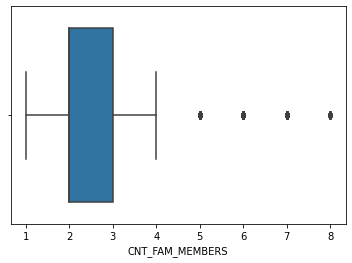

In [62]:
sns.boxplot(df1['CNT_FAM_MEMBERS']) # but 8 family members are practically possible so no need of eliminating it and cant consider it as outlier.

### ORGANIZATION_TYPE column

In [63]:
df1.ORGANIZATION_TYPE.value_counts()

Business Entity Type 3    67855
XNA                       55339
Self-employed             38384
Other                     16650
Medicine                  11176
Business Entity Type 2    10539
Government                10389
School                     8881
Trade: type 7              7817
Kindergarten               6874
Construction               6712
Business Entity Type 1     5961
Transport: type 4          5387
Trade: type 3              3484
Industry: type 9           3360
Industry: type 3           3277
Security                   3242
Housing                    2954
Industry: type 11          2699
Military                   2624
Bank                       2497
Agriculture                2454
Police                     2333
Transport: type 2          2202
Postal                     2156
Security Ministries        1964
Trade: type 2              1890
Restaurant                 1810
Services                   1573
University                 1322
Industry: type 7           1305
Transpor

In [64]:
# commonise all tyoes and subtypes of ORGANIZATION_TYPE to make it easy and convenient and also impute XNA to Unknown.
df1['ORGANIZATION_TYPE'] = df1['ORGANIZATION_TYPE'].apply(lambda x: 'Unknown' if x=='XNA' else x)

In [65]:
df1['ORGANIZATION_TYPE'] = df1['ORGANIZATION_TYPE'].apply(lambda x: x.split()[0]+ ' ' + x.split()[1] if 'Type' in x else x)

In [66]:
df1.ORGANIZATION_TYPE.value_counts()

Business Entity        84355
Unknown                55339
Self-employed          38384
Other                  16650
Medicine               11176
Government             10389
School                  8881
Trade: type 7           7817
Kindergarten            6874
Construction            6712
Transport: type 4       5387
Trade: type 3           3484
Industry: type 9        3360
Industry: type 3        3277
Security                3242
Housing                 2954
Industry: type 11       2699
Military                2624
Bank                    2497
Agriculture             2454
Police                  2333
Transport: type 2       2202
Postal                  2156
Security Ministries     1964
Trade: type 2           1890
Restaurant              1810
Services                1573
University              1322
Industry: type 7        1305
Transport: type 3       1187
Industry: type 1        1038
Hotel                    964
Electricity              948
Industry: type 4         874
Trade: type 6 

In [67]:
df1['ORGANIZATION_TYPE'] = df1['ORGANIZATION_TYPE'].apply(lambda x: x.split(':')[0] if 'type' in x else x)

In [68]:
df1.ORGANIZATION_TYPE.value_counts()

Business Entity        84355
Unknown                55339
Self-employed          38384
Other                  16650
Industry               14289
Trade                  14279
Medicine               11176
Government             10389
Transport               8976
School                  8881
Kindergarten            6874
Construction            6712
Security                3242
Housing                 2954
Military                2624
Bank                    2497
Agriculture             2454
Police                  2333
Postal                  2156
Security Ministries     1964
Restaurant              1810
Services                1573
University              1322
Hotel                    964
Electricity              948
Insurance                590
Telecom                  574
Emergency                560
Advertising              429
Realtor                  395
Culture                  379
Mobile                   317
Legal Services           302
Cleaning                 260
Religion      

#  UNIVARIATE ANALYSIS

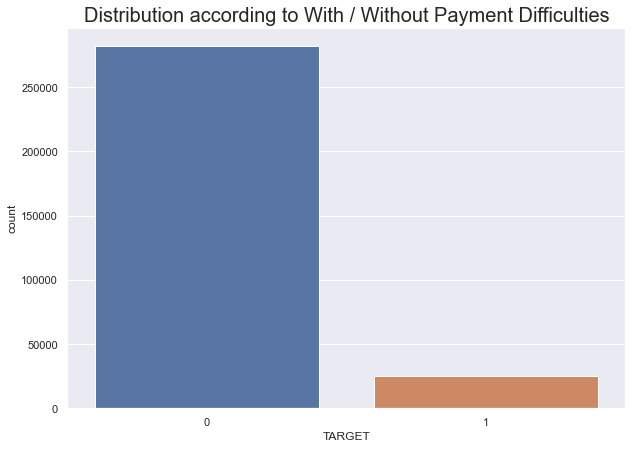

In [112]:
plt.figure(figsize=(10,7))
sns.countplot(df1['TARGET'])
plt.title("Distribution according to With / Without Payment Difficulties", fontsize= 20)
plt.show()

### Inferences :

- Percentage of customers having payment difficulties are very less as compared to customers having payment difficulties.


### Checking Data imbalance and its Ratio

In [70]:
df1.TARGET.value_counts(normalize=True)*100

0    91.920817
1     8.079183
Name: TARGET, dtype: float64

# Creating 2 separate data frames of with and without difficulties for further analysis.

In [113]:
# New data frame of customers with payment difficulties created.
difficulty = df1[df1['TARGET']==1]
difficulty.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_YEARS,EMPLOYED_YEARS
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,3648.0,2120,1,Laborers,1.0,Business Entity,0.262949,0.139376,25.920548,1.745205
26,100031,1,Cash loans,F,N,Y,0,112500.0,979992.0,27076.5,...,6573.0,1827,1,Cooking staff,1.0,Business Entity,0.548477,0.190706,51.298630,7.200000
40,100047,1,Cash loans,M,N,Y,0,202500.0,1193580.0,35028.0,...,1182.0,1029,1,Laborers,2.0,Business Entity,0.306841,0.320163,47.895890,3.457534
42,100049,1,Cash loans,F,N,N,0,135000.0,288873.0,16258.5,...,45.0,4409,1,Sales staff,2.0,Self-employed,0.674203,0.399676,36.668493,9.854795
81,100096,1,Cash loans,F,N,Y,0,81000.0,252000.0,14593.5,...,5391.0,4199,1,Unknown,2.0,Unknown,0.023952,0.720944,67.928767,1000.665753


In [114]:
# New data frame of customers without payment difficulties created.
no_difficulty = df1[df1['TARGET']==0]
no_difficulty.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT,AMT_ANNUITY,...,DAYS_REGISTRATION,DAYS_ID_PUBLISH,FLAG_MOBIL,OCCUPATION_TYPE,CNT_FAM_MEMBERS,ORGANIZATION_TYPE,EXT_SOURCE_2,EXT_SOURCE_3,AGE_YEARS,EMPLOYED_YEARS
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,1186.0,291,1,Core staff,2.0,School,0.622246,NaN,45.931507,3.254795
2,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,4260.0,2531,1,Laborers,1.0,Government,0.555912,0.729567,52.180822,0.616438
3,100006,0,Cash loans,F,N,Y,0,135000.0,312682.5,29686.5,...,9833.0,2437,1,Laborers,2.0,Business Entity,0.650442,NaN,52.068493,8.326027
4,100007,0,Cash loans,M,N,Y,0,121500.0,513000.0,21865.5,...,4311.0,3458,1,Core staff,1.0,Religion,0.322738,NaN,54.608219,8.323288
5,100008,0,Cash loans,M,N,Y,0,99000.0,490495.5,27517.5,...,4970.0,477,1,Laborers,2.0,Other,0.354225,0.621226,46.413699,4.350685


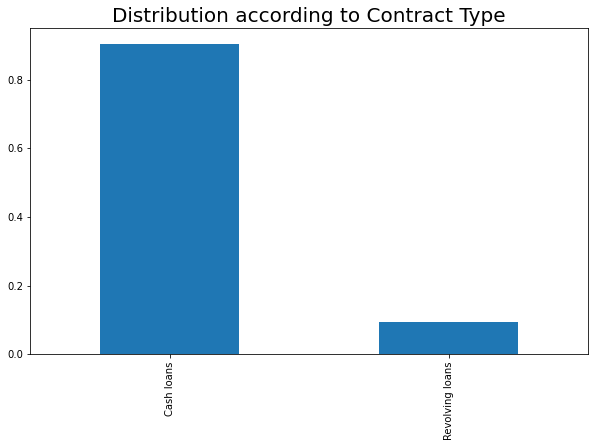

In [71]:
plt.figure(figsize=(10,6))
df1.NAME_CONTRACT_TYPE.value_counts(normalize=True).plot.bar()
plt.title("Distribution according to Contract Type", fontsize= 20)

plt.show()

## Inferences:
- Customers are more intrested in cash loans than in revolving loans.

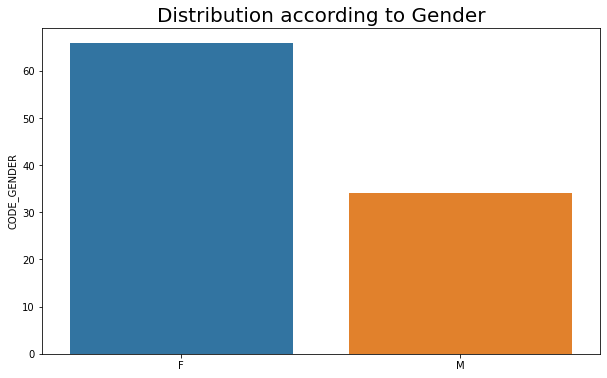

In [72]:
plt.figure(figsize=(10,6))
gender = df1.CODE_GENDER.value_counts(normalize=True)*100
sns.barplot(x=gender.index , y=gender)
plt.title("Distribution according to Gender", fontsize= 20)
plt.show()

## Inferences :
- Number of female customers is more than male custoomers

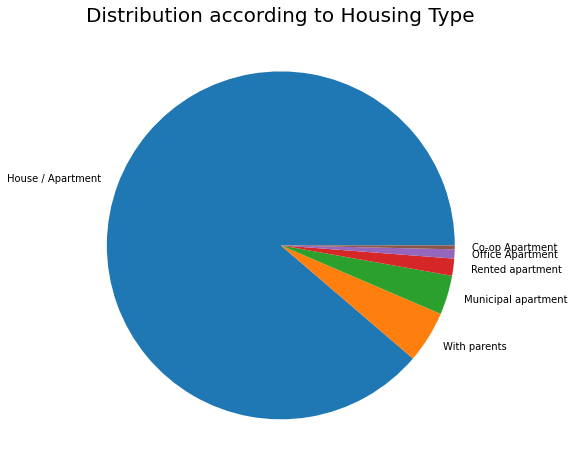

In [73]:
housing_type = df1.NAME_HOUSING_TYPE.value_counts(normalize=True)*100
plt.figure(figsize=(10,8))
plt.pie(housing_type, labels = ['House / Apartment','With parents','Municipal apartment','Rented apartment','Office Apartment','Co-op Apartment',])
plt.title("Distribution according to Housing Type", fontsize= 20)
plt.show()

## Inferences :
- Customers owning House/Appartment are significantly high in numbers.
- While Cooperative appartments and Office appartments are very less.

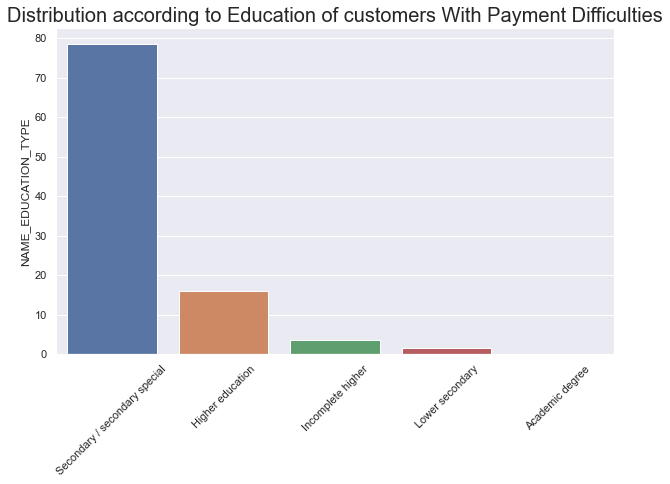

In [118]:
plt.figure(figsize=(10,6))
education = difficulty.NAME_EDUCATION_TYPE.value_counts(normalize = True)*100
sns.barplot(x=education.index, y=education)
plt.xticks(rotation = 45)
plt.title("Distribution according to Education of customers With Payment Difficulties", fontsize= 20)
plt.show()

## Inferences :
- Customers with secondary/secondary special education with payment difficulties are very high and comprise about 80% of total customers.

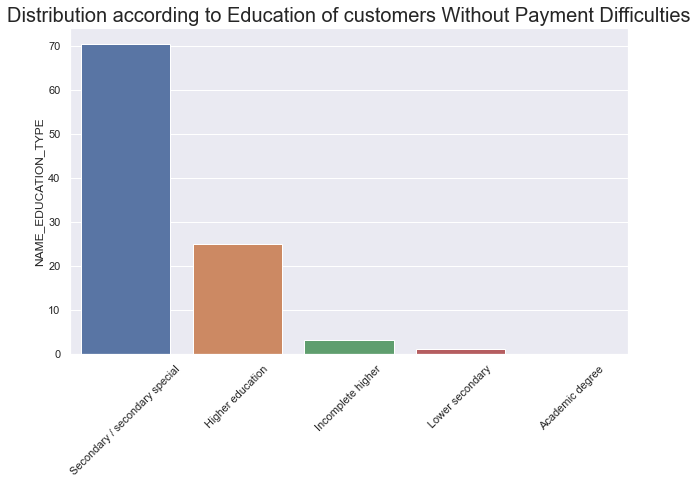

In [119]:
plt.figure(figsize=(10,6))
education = no_difficulty.NAME_EDUCATION_TYPE.value_counts(normalize = True)*100
sns.barplot(x=education.index, y=education)
plt.xticks(rotation = 45)
plt.title("Distribution according to Education of customers Without Payment Difficulties", fontsize= 20)
plt.show()

## Inferences :
- No. of Customers with higher education without payment difficulties are high compared to previous graph..

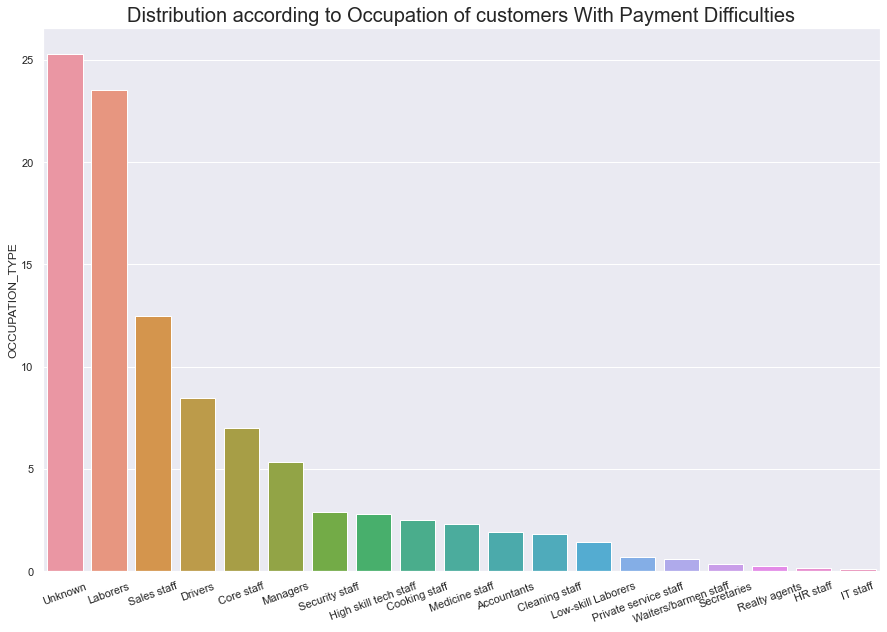

In [122]:
plt.figure(figsize=(15,10))
occupation = difficulty.OCCUPATION_TYPE.value_counts(normalize = True)*100
sns.barplot(x=occupation.index , y=occupation)
plt.xticks(rotation = 20)
plt.title("Distribution according to Occupation of customers With Payment Difficulties", fontsize= 20)
plt.show()

## Inferences :
- Customers with Unknown and labour occupation having Payment difficulties are significant and comprise about 26% and 23%       respectively.

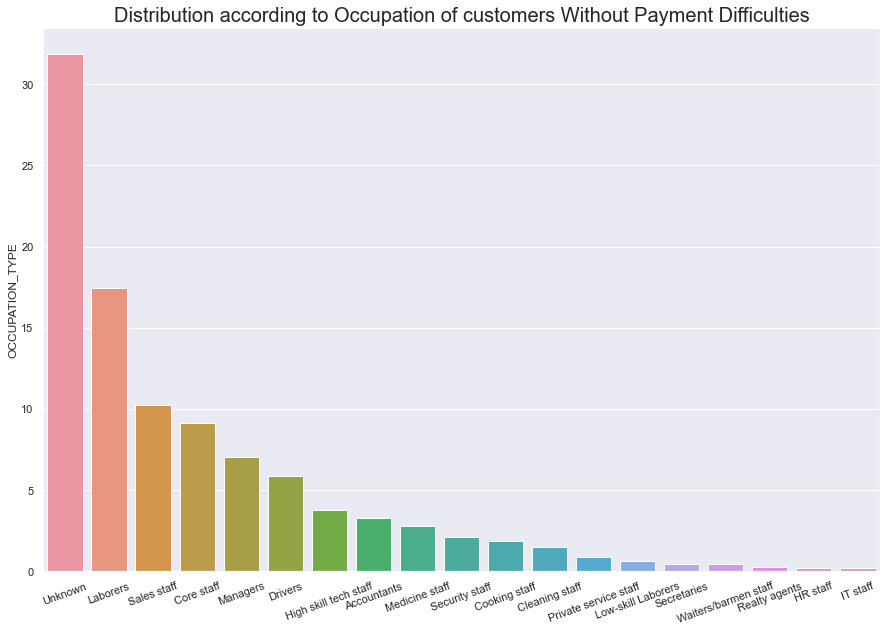

In [123]:
plt.figure(figsize=(15,10))
occupation = no_difficulty.OCCUPATION_TYPE.value_counts(normalize = True)*100
sns.barplot(x=occupation.index , y=occupation)
plt.xticks(rotation = 20)
plt.title("Distribution according to Occupation of customers Without Payment Difficulties", fontsize= 20)
plt.show()

## Inferences :
- Customers with Unknown and labour occupation without Payment difficulties are significant and comprise about 32% and 17%       respectively.

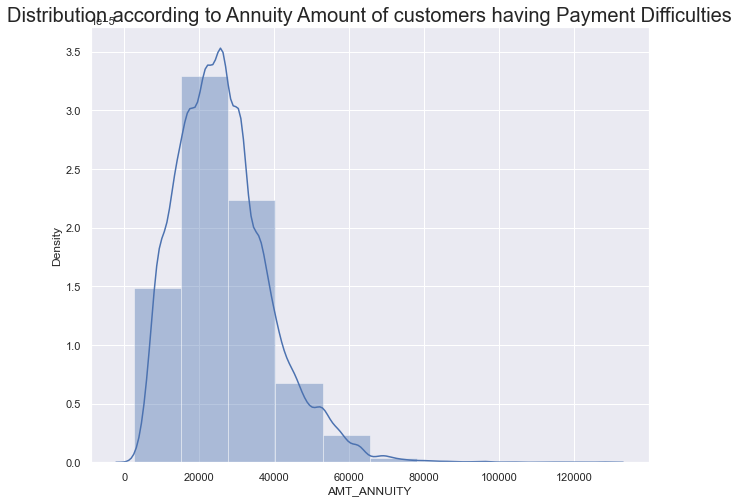

In [125]:
plt.figure(figsize=(10,8))
sns.set_theme()
sns.distplot(difficulty['AMT_ANNUITY'],bins=10)
plt.title("Distribution according to Annuity Amount of customers having Payment Difficulties", fontsize=20)
plt.show()

## Inferences :
- Customers with Annuity amount ranging in 20000 to 30000 are most.
- While customers with Annuity amount ranging above 70000 are very less. 

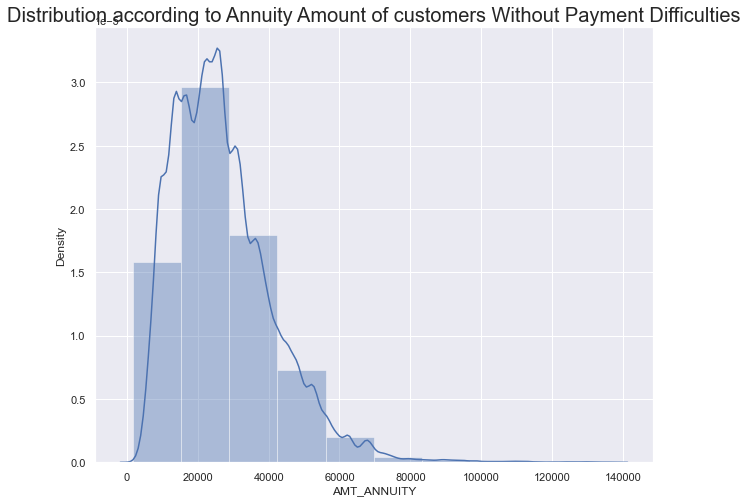

In [126]:
plt.figure(figsize=(10,8))
sns.set_theme()
sns.distplot(no_difficulty['AMT_ANNUITY'],bins=10)
plt.title("Distribution according to Annuity Amount of customers Without Payment Difficulties", fontsize=20)
plt.show()

## Inferences :
- Customers with Annuity amount ranging in 20000 to 30000 are most.
- While customers with Annuity amount ranging above 70000 are very less.

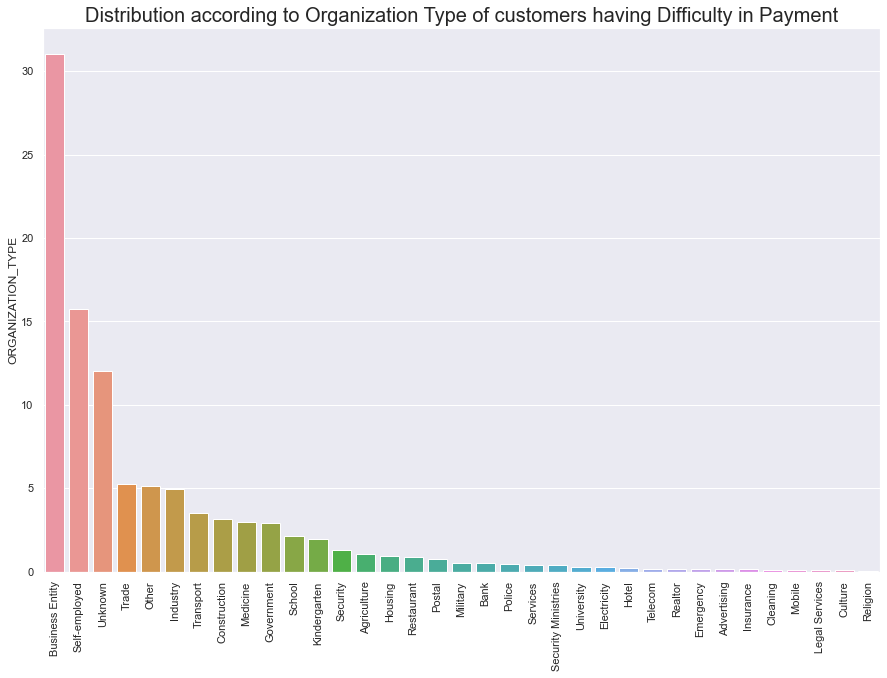

In [127]:
plt.figure(figsize=(15,10))
organization = difficulty.ORGANIZATION_TYPE.value_counts(normalize=True)*100
sns.barplot(x=organization.index , y=organization)
plt.xticks(rotation=90)
plt.title('Distribution according to Organization Type of customers having Difficulty in Payment', fontsize = 20)
plt.show()

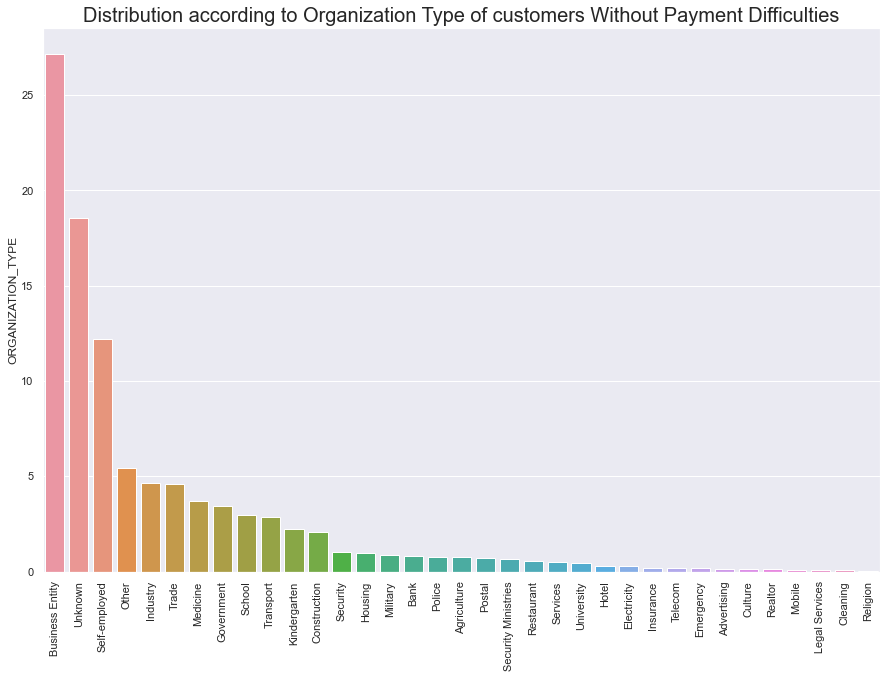

In [128]:
plt.figure(figsize=(15,10))
organization = no_difficulty.ORGANIZATION_TYPE.value_counts(normalize=True)*100
sns.barplot(x=organization.index , y=organization)
plt.xticks(rotation=90)
plt.title('Distribution according to Organization Type of customers Without Payment Difficulties', fontsize = 20)
plt.show()

# BIVARIATE ANALYSIS

In [78]:
fig = px.box(df1, x='NAME_EDUCATION_TYPE', y='AMT_CREDIT', color='NAME_FAMILY_STATUS',title='Credit Amount VS Education as per Family Status')
fig.show()

## Inferences :
- Civil marriage category with academic degree have high amount credit.
- Married category with Higher education have highest credit amount with upper fence at about 2 million.

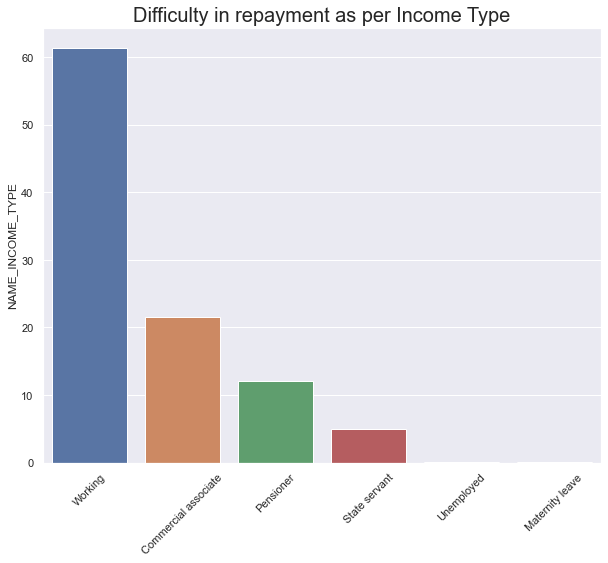

In [83]:
plt.figure(figsize=(10,8))
income = difficulty.NAME_INCOME_TYPE.value_counts(normalize=True)*100
sns.barplot(x=income.index, y=income)
plt.title('Difficulty in repayment as per Income Type', fontsize = 20)
plt.xticks(rotation = 45)
plt.show()

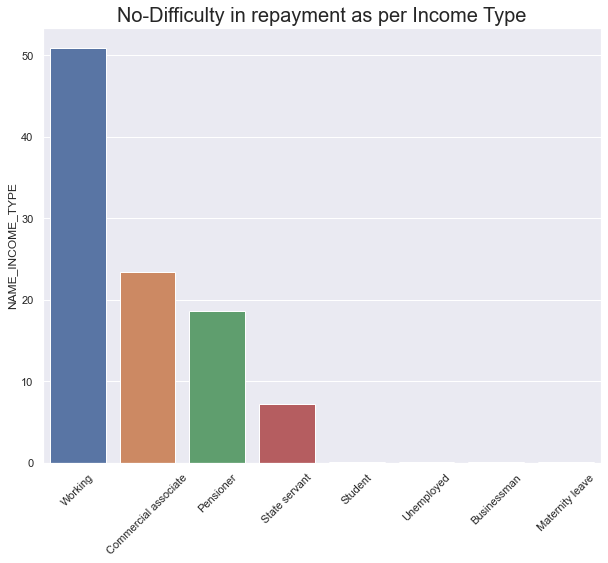

In [84]:
plt.figure(figsize=(10,8))
inc = no_difficulty.NAME_INCOME_TYPE.value_counts(normalize=True)*100
sns.barplot(x=inc.index, y=inc)
plt.title('No-Difficulty in repayment as per Income Type', fontsize = 20)
plt.xticks(rotation = 45)
plt.show()

## Inferences :
- From above 2 graphs it is clear that number of COMMERCIAL ASSOCIATE, PENSIONER & STATE SERVANTS are more in case of no difficulty in repayment.

#### Making pair plots of numeric numeric variables.

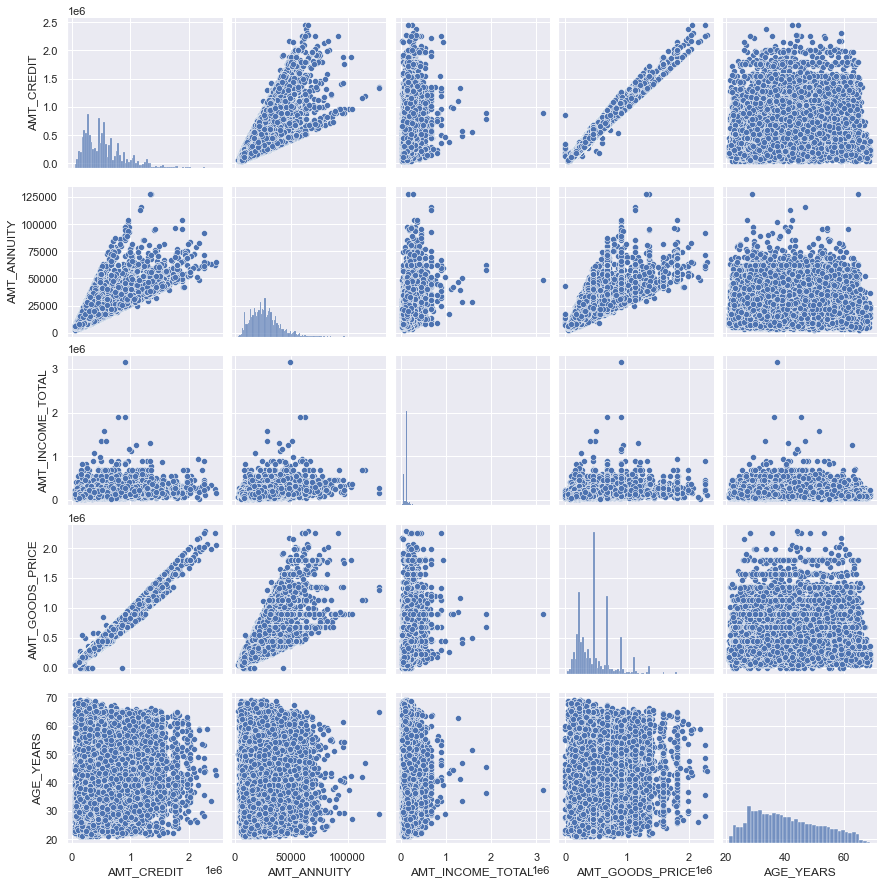

In [85]:
pair = difficulty[['AMT_CREDIT', 'AMT_ANNUITY', 'AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE', 'AGE_YEARS']].fillna(0)
sns.pairplot(pair)
plt.show()

## Pair Plot of Difficulty in repayment-
## Inferences :
- AMT_CREDIT and AMT_GOODS_PRICE has good positive linear correlation.
- AMT_ANNUITY and AMT_CREDIT also has good positive linear correlation.
- Other than this there is no any observation from above pair plot.

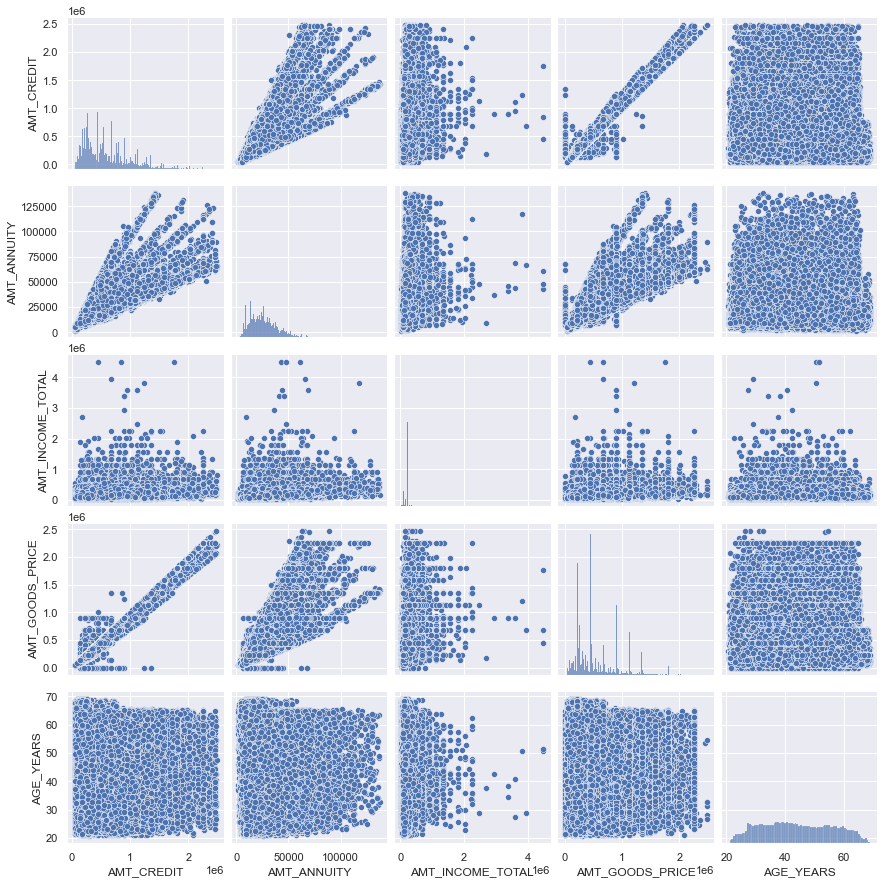

In [86]:
pair = no_difficulty[['AMT_CREDIT', 'AMT_ANNUITY', 'AMT_INCOME_TOTAL', 'AMT_GOODS_PRICE', 'AGE_YEARS']].fillna(0)
sns.pairplot(pair)
plt.show()

## Pair Plot of No Difficulty in repayment-
## Inferences :
- AMT_CREDIT and AMT_GOODS_PRICE has good positive linear correlation.
- AMT_ANNUITY and AMT_CREDIT also has good positive linear correlation.
- Other than this there is no any observation from above pair plot.

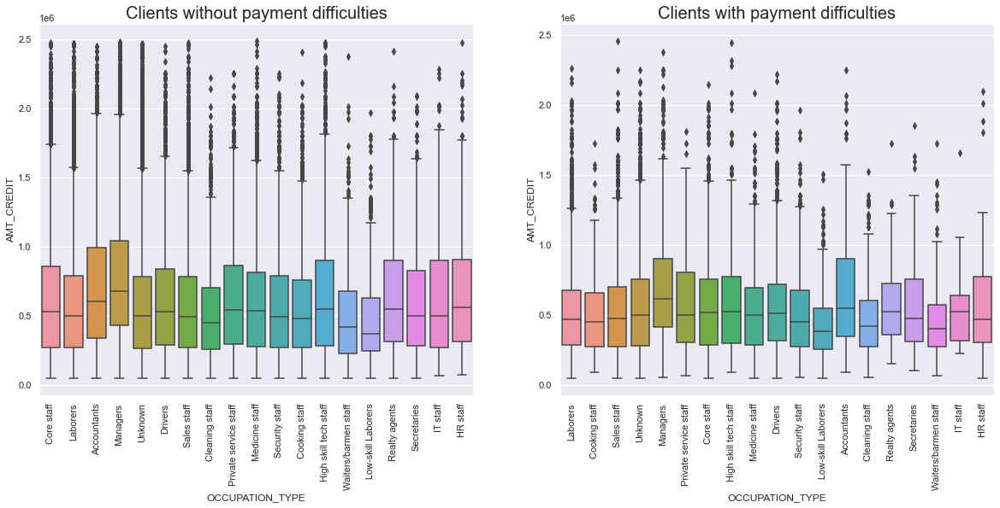

In [87]:
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
ax = sns.boxplot(data = no_difficulty, y = 'AMT_CREDIT', x = 'OCCUPATION_TYPE')
plt.title('Clients without payment difficulties', fontsize=20)
plt.xticks(rotation=90)

plt.subplot(1,2,2)
ax = sns.boxplot(data=difficulty,y='AMT_CREDIT',x='OCCUPATION_TYPE')
plt.title('Clients with payment difficulties', fontsize=20)
plt.xticks(rotation=90)
plt.show()

## Inferences :
- Range of customers without payment difficulties is more as compared to customers with payment difficulties.
- Number of outliers of customers without payment difficulties is more as compared to customers with payment difficulties.

# Now we will proceed for PREVIOUS APPLICATION DATA file.

In [94]:
inp1.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,WEEKDAY_APPR_PROCESS_START,HOUR_APPR_PROCESS_START,...,NAME_SELLER_INDUSTRY,CNT_PAYMENT,NAME_YIELD_GROUP,PRODUCT_COMBINATION,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,SATURDAY,15,...,Connectivity,12.0,middle,POS mobile with interest,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,THURSDAY,11,...,XNA,36.0,low_action,Cash X-Sell: low,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,TUESDAY,11,...,XNA,12.0,high,Cash X-Sell: high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,MONDAY,7,...,XNA,12.0,middle,Cash X-Sell: middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,THURSDAY,9,...,XNA,24.0,high,Cash Street: high,NaN,NaN,NaN,NaN,NaN,NaN


In [95]:
inp1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 37 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1670214 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   WEEKDAY_APPR_PROCESS_START   1670214 non-null  object 
 9   HOUR_APPR_PROCESS_START      1670214 non-null  int64  
 10  FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 11  NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 12  RATE_DOWN_PAYMENT            774370 non-nu

In [96]:
inp1.isnull().sum()

SK_ID_PREV                           0
SK_ID_CURR                           0
NAME_CONTRACT_TYPE                   0
AMT_ANNUITY                     372235
AMT_APPLICATION                      0
AMT_CREDIT                           1
AMT_DOWN_PAYMENT                895844
AMT_GOODS_PRICE                 385515
WEEKDAY_APPR_PROCESS_START           0
HOUR_APPR_PROCESS_START              0
FLAG_LAST_APPL_PER_CONTRACT          0
NFLAG_LAST_APPL_IN_DAY               0
RATE_DOWN_PAYMENT               895844
RATE_INTEREST_PRIMARY          1664263
RATE_INTEREST_PRIVILEGED       1664263
NAME_CASH_LOAN_PURPOSE               0
NAME_CONTRACT_STATUS                 0
DAYS_DECISION                        0
NAME_PAYMENT_TYPE                    0
CODE_REJECT_REASON                   0
NAME_TYPE_SUITE                 820405
NAME_CLIENT_TYPE                     0
NAME_GOODS_CATEGORY                  0
NAME_PORTFOLIO                       0
NAME_PRODUCT_TYPE                    0
CHANNEL_TYPE             

In [130]:
missing = 100*inp1.isnull().sum()/len(inp1)
missing

SK_ID_PREV                      0.000000
SK_ID_CURR                      0.000000
NAME_CONTRACT_TYPE              0.000000
AMT_ANNUITY                    22.286665
AMT_APPLICATION                 0.000000
AMT_CREDIT                      0.000060
AMT_DOWN_PAYMENT               53.636480
AMT_GOODS_PRICE                23.081773
WEEKDAY_APPR_PROCESS_START      0.000000
HOUR_APPR_PROCESS_START         0.000000
FLAG_LAST_APPL_PER_CONTRACT     0.000000
NFLAG_LAST_APPL_IN_DAY          0.000000
RATE_DOWN_PAYMENT              53.636480
RATE_INTEREST_PRIMARY          99.643698
RATE_INTEREST_PRIVILEGED       99.643698
NAME_CASH_LOAN_PURPOSE          0.000000
NAME_CONTRACT_STATUS            0.000000
DAYS_DECISION                   0.000000
NAME_PAYMENT_TYPE               0.000000
CODE_REJECT_REASON              0.000000
NAME_TYPE_SUITE                49.119754
NAME_CLIENT_TYPE                0.000000
NAME_GOODS_CATEGORY             0.000000
NAME_PORTFOLIO                  0.000000
NAME_PRODUCT_TYP

In [131]:
drop_columns = missing[missing>=20]
drop_columns

AMT_ANNUITY                  22.286665
AMT_DOWN_PAYMENT             53.636480
AMT_GOODS_PRICE              23.081773
RATE_DOWN_PAYMENT            53.636480
RATE_INTEREST_PRIMARY        99.643698
RATE_INTEREST_PRIVILEGED     99.643698
NAME_TYPE_SUITE              49.119754
CNT_PAYMENT                  22.286366
DAYS_FIRST_DRAWING           40.298129
DAYS_FIRST_DUE               40.298129
DAYS_LAST_DUE_1ST_VERSION    40.298129
DAYS_LAST_DUE                40.298129
DAYS_TERMINATION             40.298129
NFLAG_INSURED_ON_APPROVAL    40.298129
dtype: float64

In [132]:
# According to observations we can drop following columns for reducing unnecessary data.
drop_columns = ['CODE_REJECT_REASON','NAME_GOODS_CATEGORY','WEEKDAY_APPR_PROCESS_START','HOUR_APPR_PROCESS_START','NAME_PORTFOLIO','NAME_PRODUCT_TYPE','CHANNEL_TYPE','SELLERPLACE_AREA','NAME_SELLER_INDUSTRY','PRODUCT_COMBINATION']
inp2 = inp1.drop(columns = drop_columns)

In [133]:
inp2.shape

(1670214, 27)

In [134]:
inp2.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,...,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,CNT_PAYMENT,NAME_YIELD_GROUP,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,Y,1,...,NaN,Repeater,12.0,middle,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,Y,1,...,Unaccompanied,Repeater,36.0,low_action,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,Y,1,...,"Spouse, partner",Repeater,12.0,high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,Y,1,...,NaN,Repeater,12.0,middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,Y,1,...,NaN,Repeater,24.0,high,NaN,NaN,NaN,NaN,NaN,NaN


In [135]:
# in above table we can see some sells have XAP and XNA for data unavailability so we shouls convert it into NaN.
inp2 = inp2.replace('XNA', np.NaN)
inp2 = inp2.replace('XAP', np.NaN)
inp2.head()

,SK_ID_PREV,SK_ID_CURR,NAME_CONTRACT_TYPE,AMT_ANNUITY,AMT_APPLICATION,AMT_CREDIT,AMT_DOWN_PAYMENT,AMT_GOODS_PRICE,FLAG_LAST_APPL_PER_CONTRACT,NFLAG_LAST_APPL_IN_DAY,...,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,CNT_PAYMENT,NAME_YIELD_GROUP,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,2030495,271877,Consumer loans,1730.430,17145.0,17145.0,0.0,17145.0,Y,1,...,NaN,Repeater,12.0,middle,365243.0,-42.0,300.0,-42.0,-37.0,0.0
1,2802425,108129,Cash loans,25188.615,607500.0,679671.0,NaN,607500.0,Y,1,...,Unaccompanied,Repeater,36.0,low_action,365243.0,-134.0,916.0,365243.0,365243.0,1.0
2,2523466,122040,Cash loans,15060.735,112500.0,136444.5,NaN,112500.0,Y,1,...,"Spouse, partner",Repeater,12.0,high,365243.0,-271.0,59.0,365243.0,365243.0,1.0
3,2819243,176158,Cash loans,47041.335,450000.0,470790.0,NaN,450000.0,Y,1,...,NaN,Repeater,12.0,middle,365243.0,-482.0,-152.0,-182.0,-177.0,1.0
4,1784265,202054,Cash loans,31924.395,337500.0,404055.0,NaN,337500.0,Y,1,...,NaN,Repeater,24.0,high,NaN,NaN,NaN,NaN,NaN,NaN


In [136]:
inp2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1670214 entries, 0 to 1670213
Data columns (total 27 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_PREV                   1670214 non-null  int64  
 1   SK_ID_CURR                   1670214 non-null  int64  
 2   NAME_CONTRACT_TYPE           1669868 non-null  object 
 3   AMT_ANNUITY                  1297979 non-null  float64
 4   AMT_APPLICATION              1670214 non-null  float64
 5   AMT_CREDIT                   1670213 non-null  float64
 6   AMT_DOWN_PAYMENT             774370 non-null   float64
 7   AMT_GOODS_PRICE              1284699 non-null  float64
 8   FLAG_LAST_APPL_PER_CONTRACT  1670214 non-null  object 
 9   NFLAG_LAST_APPL_IN_DAY       1670214 non-null  int64  
 10  RATE_DOWN_PAYMENT            774370 non-null   float64
 11  RATE_INTEREST_PRIMARY        5951 non-null     float64
 12  RATE_INTEREST_PRIVILEGED     5951 non-null

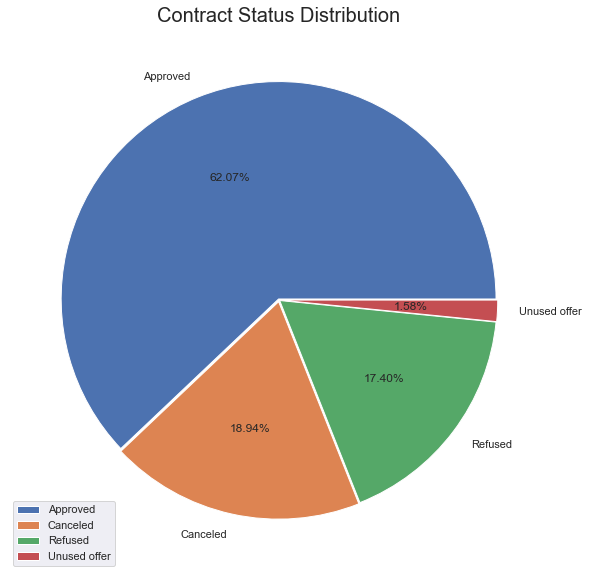

In [137]:
contract_status = inp2.NAME_CONTRACT_STATUS.value_counts(normalize=True)*100
plt.figure(figsize=(15,10))
explode = (0.005,0.008,0.004,0.006)
contract_status.plot.pie(explode = explode,autopct='%1.2f%%')
plt.title('Contract Status Distribution', fontsize = 20)
plt.legend()
plt.ylabel('')
plt.show()

## Inferences :
- 62% of customers are Approved.
- Only 1.58% customers have unused offer.

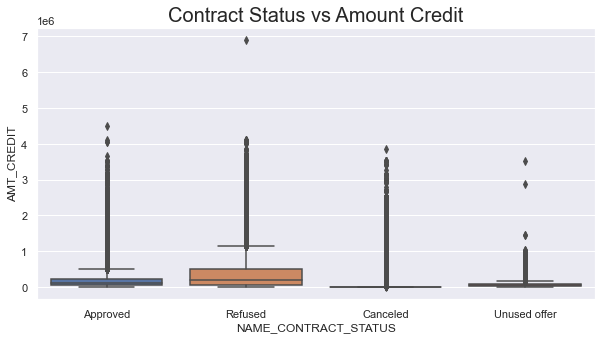

In [138]:
plt.figure(figsize=(10,5)) 
sns.boxplot(data=inp2,y='AMT_CREDIT',x='NAME_CONTRACT_STATUS')
plt.title('Contract Status vs Amount Credit', fontsize = 20)
plt.show()

## Inferences :
- Refused customers have highest amount of credit.
- Cancelled customers have lower=st or near to 0 credit amount.

# Merging The Application Data and Previous Application Data

In [139]:
new_df = pd.merge(left = df1, right = inp2, how = 'inner', on = 'SK_ID_CURR')
new_df.head()

,SK_ID_CURR,TARGET,NAME_CONTRACT_TYPE_x,CODE_GENDER,FLAG_OWN_CAR,FLAG_OWN_REALTY,CNT_CHILDREN,AMT_INCOME_TOTAL,AMT_CREDIT_x,AMT_ANNUITY_x,...,NAME_TYPE_SUITE,NAME_CLIENT_TYPE,CNT_PAYMENT,NAME_YIELD_GROUP,DAYS_FIRST_DRAWING,DAYS_FIRST_DUE,DAYS_LAST_DUE_1ST_VERSION,DAYS_LAST_DUE,DAYS_TERMINATION,NFLAG_INSURED_ON_APPROVAL
0,100002,1,Cash loans,M,N,Y,0,202500.0,406597.5,24700.5,...,NaN,New,24.0,low_normal,365243.0,-565.0,125.0,-25.0,-17.0,0.0
1,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,Unaccompanied,Repeater,12.0,low_normal,365243.0,-716.0,-386.0,-536.0,-527.0,1.0
2,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,Family,Refreshed,6.0,middle,365243.0,-797.0,-647.0,-647.0,-639.0,0.0
3,100003,0,Cash loans,F,N,N,0,270000.0,1293502.5,35698.5,...,Family,Refreshed,12.0,middle,365243.0,-2310.0,-1980.0,-1980.0,-1976.0,1.0
4,100004,0,Revolving loans,M,Y,Y,0,67500.0,135000.0,6750.0,...,Unaccompanied,New,4.0,middle,365243.0,-784.0,-694.0,-724.0,-714.0,0.0


In [140]:
new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 1412814 entries, 0 to 1412813
Data columns (total 51 columns):
 #   Column                       Non-Null Count    Dtype  
---  ------                       --------------    -----  
 0   SK_ID_CURR                   1412814 non-null  int64  
 1   TARGET                       1412814 non-null  int64  
 2   NAME_CONTRACT_TYPE_x         1412814 non-null  object 
 3   CODE_GENDER                  1412814 non-null  object 
 4   FLAG_OWN_CAR                 1412814 non-null  object 
 5   FLAG_OWN_REALTY              1412814 non-null  object 
 6   CNT_CHILDREN                 1412814 non-null  int64  
 7   AMT_INCOME_TOTAL             1412814 non-null  float64
 8   AMT_CREDIT_x                 1412814 non-null  float64
 9   AMT_ANNUITY_x                1412814 non-null  float64
 10  AMT_GOODS_PRICE_x            1411606 non-null  float64
 11  NAME_INCOME_TYPE             1412814 non-null  object 
 12  NAME_EDUCATION_TYPE          1412814 non-n

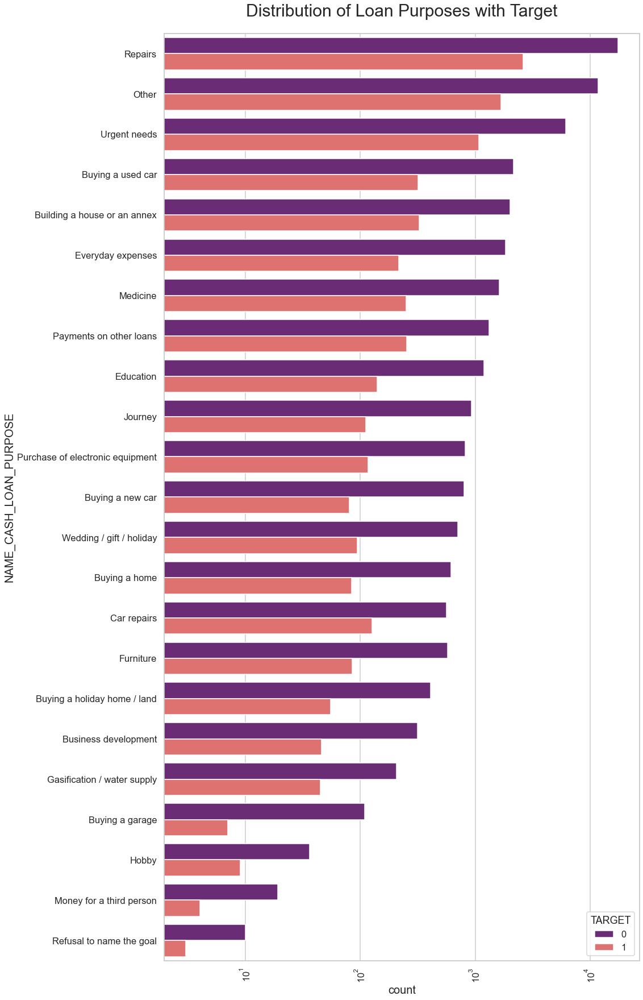

In [185]:
sns.set_style('whitegrid')
sns.set_context('talk')

plt.figure(figsize=(15,30))
plt.rcParams["axes.labelsize"] = 20
plt.rcParams['axes.titlesize'] = 22
plt.rcParams['axes.titlepad'] = 30
plt.xticks(rotation=90)
plt.xscale('log')
plt.title('Distribution of Loan Purposes with Target', fontsize = 30)
ax = sns.countplot(data = new_df, y= 'NAME_CASH_LOAN_PURPOSE', 
                   order=new_df['NAME_CASH_LOAN_PURPOSE'].value_counts().index,hue = 'TARGET',palette='magma')

## Inferences :
- Loan purposes with 'Repairs' are facing more difficulites in payment on time.
- There are few places where loan repayment is significantly higher than facing difficulties. They are 'Buying a garage', 'Business developemt', 'Buying land','Buying a new car' and 'Education' Hence we can focus on these purposes for which the client is having for minimal payment difficulties

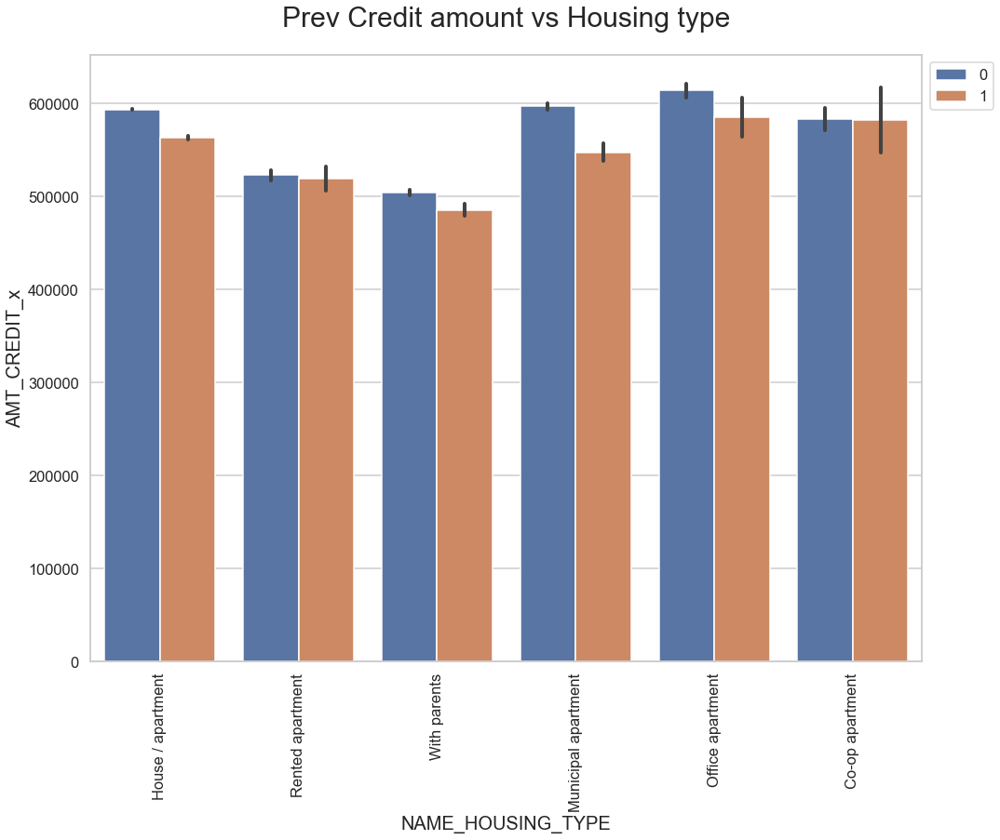

In [184]:
# Here AMT_CREDIT_x means the previous credit amount.
plt.figure(figsize=(16,12))
plt.xticks(rotation=90)
sns.barplot(data =new_df, y='AMT_CREDIT_x',hue='TARGET',x='NAME_HOUSING_TYPE')
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.title('Prev Credit amount vs Housing type', fontsize = 30)
plt.show()

## Inferences :
- For Housing type, office appartment is having higher credit of target 0 and co-op apartment is having higher credit of target 1. So, we can conclude that bank should avoid giving loans to the housing type of co-op apartment as they are having difficulties in payment. Bank can focus mostly on housing type with parents or House\appartment or miuncipal appartment for successful payments

                        AMT_CREDIT_x                                     \
NAME_EDUCATION_TYPE  Academic degree Higher education Incomplete higher   
NAME_CONTRACT_STATUS                                                      
Approved               723141.775120    669145.703296     583876.240583   
Canceled               746378.789062    645885.216914     574878.025960   
Refused                689632.912088    633546.022000     539767.298819   
Unused offer           448038.750000    639116.586885     544836.158698   

                                                                    
NAME_EDUCATION_TYPE  Lower secondary Secondary / secondary special  
NAME_CONTRACT_STATUS                                                
Approved               498283.848646                 575592.256033  
Canceled               496326.399322                 561724.017298  
Refused                488128.371255                 542516.140520  
Unused offer           489592.336364                 562185.

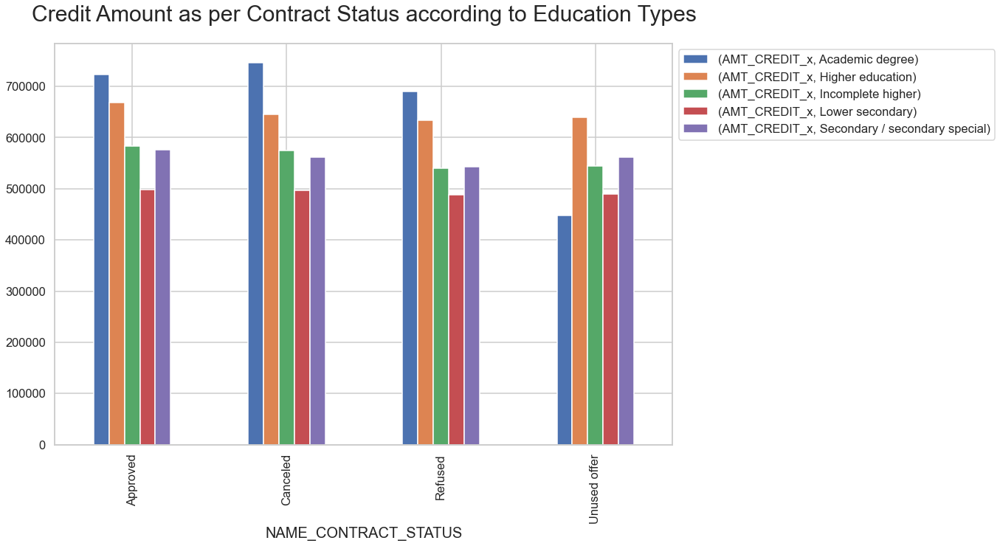

In [181]:
# Creating pivot table of Contract Status Vs Amount Credit with respect to Education type.
# Then plotting its graph
table_1 = pd.pivot_table(new_df,values = ['AMT_CREDIT_x'], index = ['NAME_CONTRACT_STATUS'], columns = ['NAME_EDUCATION_TYPE'])
print(table_1)
table_1.plot(kind="bar", figsize=(15,10),stacked=False)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.title('Credit Amount as per Contract Status according to Education Types', fontsize = 30)
plt.show()

## Inferences :
- No of customers with higher education and incomplete higher education are more likely approved as compared to other contract status.
- Customers with academic drgree are more likely to cancel the loan application.

                       AMT_CREDIT_x                              
NAME_CLIENT_TYPE                New      Refreshed       Repeater
NAME_CONTRACT_STATUS                                             
Approved              574386.998510  604324.371181  603422.139215
Canceled              520943.737924  577606.273363  580716.824244
Refused               564493.212533  551911.118626  562368.981452
Unused offer          553175.843164  576968.639894  588132.335490


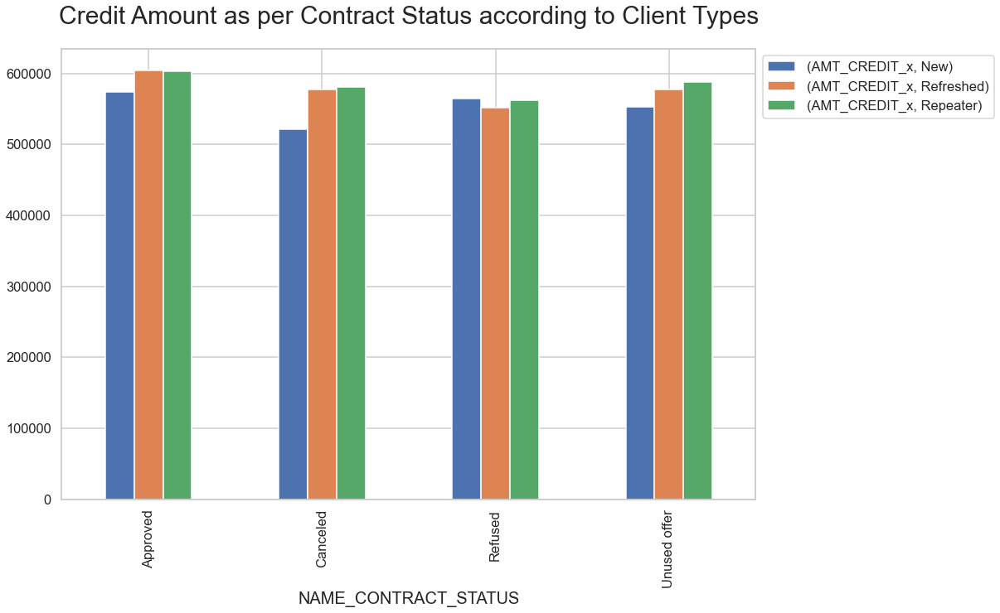

In [182]:
# Creating pivot table of Contract Status Vs Credit Amount with respect to Client Types.
# Then plotting its graph
table_2 = pd.pivot_table(new_df,values = ['AMT_CREDIT_x'], index = ['NAME_CONTRACT_STATUS'], columns = ['NAME_CLIENT_TYPE'])
print(table_2)
table_2.plot(kind="bar", figsize=(15,10),stacked=False)
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.title('Credit Amount as per Contract Status according to Client Types', fontsize = 30)
plt.show()

## Inferences :
- Refreshed and Repeater Customers are approved with highest credit amount.
- New customers with credit amount between 5-6 lakhs are more likely refused as compared toother two customer types.

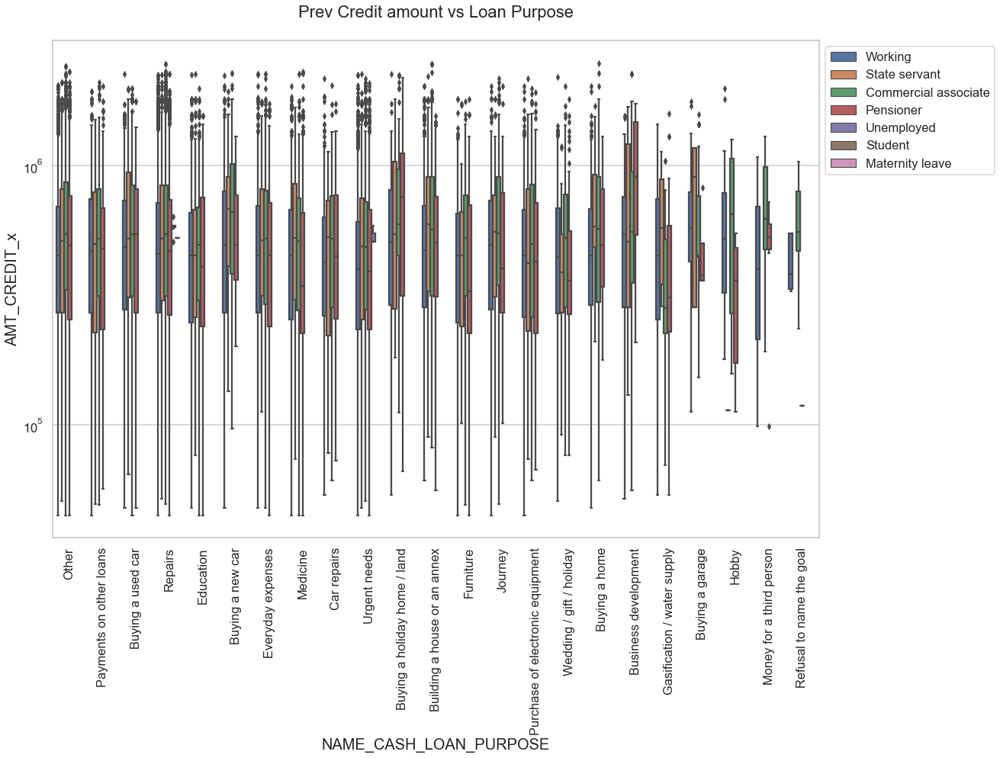

In [186]:
plt.figure(figsize=(18,12))
plt.xticks(rotation=90)
plt.yscale('log')
sns.boxplot(data =new_df, x='NAME_CASH_LOAN_PURPOSE',hue='NAME_INCOME_TYPE',y='AMT_CREDIT_x',orient='v')
plt.legend(bbox_to_anchor=(1,1), loc="upper left")
plt.title('Prev Credit amount vs Loan Purpose')
plt.show()

## Inferences :
- The credit amount of Loan purposes like 'Buying a home','Buying a land','Buying a new car' and'Building a house' is higher.
- Income type of state servants have a significant amount of credit applied
- Money for third person or a Hobby is having less credits applied for.

#  THE END
#  THANK YOU